# Face Detection
## Goal: Build a face detection system using Scikit-learn. The pipeline must be able to:
Take an input image.

1.   Take an input image
2.   Return a list of bounding box coordinates where faces are present
3.   Return an empty list if there are no faces in the image

In [ ]:
!pip install flaml
!pip install ray
!pip install dask

### Load Libraries

In [1]:
import json
import os
import shutil
import cv2
import numpy as np
import joblib
import seaborn as sns
import matplotlib.pyplot as plt
from skimage.feature import hog
from skimage import exposure


# Utils
import os, shutil
import cv2
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns
import time
import json
import random
import pickle

# Feature extraction
from skimage.feature import hog
from skimage import exposure


# Model creation and train
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV, RepeatedKFold
from sklearn.model_selection import train_test_split, validation_curve
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, f1_score, roc_auc_score, roc_curve, auc
from sklearn.svm import SVC, SVR
from flaml.automl.model import SKLearnEstimator
from flaml import tune
from flaml.automl.task.task import CLASSIFICATION
from flaml import AutoML

# Cell colab
import imutils
from IPython import display # Per tenere il display
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

## Load the useful function

### Function to train the model

In [ ]:
# Defining function to crete pathces list
def create_patch_list(base_url, size, nested=False):
    """
    Creates a list of grayscale image patches from a directory of images.
    Args:
        base_url: The base directory of the images.
        size: The desired size of the patches as tuple (width, height).
        nested: Boolean indicating if images are in nested directories.
    Returns:
        A NumPy array containing the grayscale image patches.
    """
    patches = []
    if nested:
        # Handle nested directories (for houses)
        for folder in os.listdir(base_url):
            folder_path = os.path.join(base_url, folder)
            if os.path.isdir(folder_path):
                for filename in os.listdir(folder_path):
                    img_path = os.path.join(folder_path, filename)
                    img = cv2.imread(img_path)
                    if img is None:
                        print(f"Error loading image: {img_path}")
                        continue
                    img = cv2.resize(img, size)
                    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
                    patches.append(gray)
    else:
        # Handle flat directory (for landscapes)
        for filename in os.listdir(base_url):
            img_path = os.path.join(base_url, filename)
            img = cv2.imread(img_path)
            if img is None:
                print(f"Error loading image: {img_path}")
                continue
            img = cv2.resize(img, size)
            gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            patches.append(gray)

    return np.array(patches)


# In order to test the correct creation of patches, plot image randmoly
def test_plot(img_list):
  print("\nLoad photo for checking...\n")
  plt.imshow(img_list[0], cmap = "gray")
    


def mirror_images(images):
    mirrored_images = [cv2.flip(img, 1) for img in images]
    # Combine the original images with their mirrored versions
    augmented_images = images + mirrored_images
    return augmented_images


def simulate_distance_variation(image, scale_factors):
    """
    Simulate distance variation by resizing an image with different scale factors.

    Args:
        image (numpy.ndarray): The input image to be resized.
        scale_factors (list): A list of scale factors to simulate distance variation.

    Returns:
        list: A list of resized images as NumPy arrays.
    """
    augmented_images = []
    # Resize the input image with different scale factors
    for scale in scale_factors:
        # Resize the image using OpenCV's resize function
        resized_image = cv2.resize(image, None, fx=scale, fy=scale, interpolation=cv2.INTER_LINEAR)
        # Append the resized image to the list of augmented_images
        augmented_images.append(resized_image)
    return augmented_images


def extract_random_patches(image, num_patches, patch_size):
    """
    Extract random patches from an image.

    Args:
        image (numpy.ndarray): The input image from which patches will be extracted.
        num_patches (int): The number of patches to extract.
        patch_size (tuple): A tuple representing the size of each patch in (height, width).

    Returns:
        list: A list of extracted patches as NumPy arrays.
    """
    # Get the height and width of the input image
    height, width = image.shape[:2]
    patches = []
    # Extract the specified number of random patches
    for _ in range(num_patches):
        # Generate random coordinates for the top-left corner of the patch
        x = random.randint(0, width - patch_size[0])
        y = random.randint(0, height - patch_size[1])
        # Extract the patch using the generated coordinates
        patch = image[y:y + patch_size[1], x:x + patch_size[0]]
        # Append the extracted patch to the list of patches
        patches.append(patch)
    return patches

def resize_image(image, width, height):
    """
    Resize an image to the specified width and height.

    Args:
        image (numpy.ndarray): The input image to be resized.
        width (int): The desired width of the resized image.
        height (int): The desired height of the resized image.

    Returns:
        numpy.ndarray: The resized image as a NumPy array.
    """
    # Resize the image using OpenCV's resize function
    resized_image = cv2.resize(image, (width, height))
    return resized_image

def get_hog_features(image, resize_width=64, resize_height=64, orient=9, pix_per_cell=8, cell_per_block=2):
    """
    Extract HOG features from an image.

    Args:
        image (numpy.ndarray): The input image to extract HOG features from.

    Returns:
        numpy.ndarray: Extracted HOG features as a 1D array.
    """
    try:
        # Controlla se l'immagine è già in scala di grigi
        if len(image.shape) == 3:  # Verifica che l'immagine abbia 3 canali
            gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        else:
            gray = image  # L'immagine è già in scala di grigi

        # Ridimensiona l'immagine alla dimensione desiderata per HOG
        resized_image = resize_image(gray, resize_width, resize_height)

        # Estrai le caratteristiche HOG
        features = hog(resized_image, orientations=orient, pixels_per_cell=(pix_per_cell, pix_per_cell),
                       cells_per_block=(cell_per_block, cell_per_block), block_norm='L2-Hys', transform_sqrt=True,
                       feature_vector=True)

        # Equalizza l'istogramma per migliorare la visibilità delle caratteristiche
        features = exposure.equalize_hist(features)
        return features
    except Exception as e:
        print(f"Errore nell'elaborazione dell'immagine: {e}")
        return None  # Restituisce None se c'è un errore

### Three useful ML functions

In [ ]:
# Function to convert datset in numpy array
def to_array(data, valid_types=(np.ndarray, pd.DataFrame, pd.Series)):
    return data if isinstance(data, valid_types) else np.array(data)


def evaluate_model(model, X_train, y_train, X_test, y_test):
    model.fit(X_train, y_train)

    y_pred_train = model.predict(X_train)
    y_proba_train = model.predict_proba(X_train)[:, 1]

    y_pred_test = model.predict(X_test)
    y_proba_test = model.predict_proba(X_test)[:, 1]

    train_accuracy = accuracy_score(y_train, y_pred_train)
    train_f1 = f1_score(y_train, y_pred_train)
    train_roc_auc = roc_auc_score(y_train, y_proba_train)

    test_accuracy = accuracy_score(y_test, y_pred_test)
    test_f1 = f1_score(y_test, y_pred_test)
    test_roc_auc = roc_auc_score(y_test, y_proba_test)

    print(f"TRAIN Accuracy: {train_accuracy:.2f}")
    print(f"TRAIN F1 Score: {train_f1:.2f}")
    print(f"TRAIN ROC AUC: {train_roc_auc:.2f}")

    print(f"TEST Accuracy: {test_accuracy:.2f}")
    print(f"TEST F1 Score: {test_f1:.2f}")
    print(f"TEST ROC AUC: {test_roc_auc:.2f}")

    print("\nTEST REPORT")
    print(classification_report(y_test, y_pred_test))

    print("\nConfusion Matrix - Training Set")
    plot_confusion_matrix(y_train, y_pred_train)

    print("\nConfusion Matrix - Test Set")
    plot_confusion_matrix(y_test, y_pred_test)

def plot_confusion_matrix(y_true, y_pred, labels=["Negative", "Positive"], show_precision_recall=True):
    cm = confusion_matrix(y_true, y_pred)

    df_cm = pd.DataFrame(cm, index=labels,
                         columns=["Predicted " + labels[0], "Predicted " + labels[1]])
    sns.heatmap(df_cm, annot=True, fmt='g')

    if show_precision_recall:
        precision = cm[1, 1] / (cm[1, 1] + cm[0, 1])
        recall = cm[1, 1] / (cm[1, 1] + cm[1, 0])
        plt.text(0, -0.1, f"Precision: {precision:.3f}")
        plt.text(1, -0.1, f"Recall: {recall:.3f}")
    plt.show()

### Creation of SKLearnEstimator in order to use in FLAML

In [ ]:
# Derrive from the base class SKLearnEstimator
# SKLearnEstimator only works for scikit-learn compatible object (i.e those that has .fit and .predict methods)
# For more general estimator, derive from BaseEstimator instead
class SVM(SKLearnEstimator):

  # The task argument here is necessary as an initialization
  # By default FLAML sets n_jobs parameter. This is used in SVM
  # ... thus we explicitly set it to None
  def __init__(self, n_jobs = None, task = 'classification', **config):
    super().__init__(task, **config)

    # We only need to modify the estimator_class according to the task
    # SVC is for classification, SVR is for regression
    if task in CLASSIFICATION:
      self.estimator_class = SVC
    else:
      self.estimator_class = SVR

  # Any estimator must also include hyperparameter space
  # These are the model (i.e SVM) parameters that will be tuned by FLAML
  @classmethod
  def search_space(cls, data_size, task):
    # We will optimize C, kernel type, and maximum solver iteration

    # uniform and loguniform is used for float
    # randint and lograndint is used for integers
    # choice is used for categories

    space = {
        # C values between 0.5 and 4 (float)
        "C":{
            "domain": tune.uniform(lower = 0.5, upper = 4.0)
        },
        # Kernel could be linear, radial basis, or polynomial
        # Additionally, we can specify the "fastest" (low time-cost) configuration
        "kernel":{
            "domain": tune.choice(['linear', 'rbf', 'poly']),
            "low_cost_init_value": 'linear'
        },
        # Max solver iteration (integer), it is usually necessary to put hard limit on SVM
        "max_iter":{
            "domain": tune.randint(lower = 100, upper = 1000),
            "low_cost_init_value": 100
        },
        # Probability
        "probability":{
            "domain": tune.choice([True]),
        }
    }

    return space


# Function to define the precision metric in order to use
#Metric. As a general guide, in classification we want to maximize accuracy, precision, recall, or F1-score. 
#Precision is not defined in FLAML for this reason a function is implmemented
def precision_metric(X_val, y_val, estimator, labels,
                     X_train, y_train, weight_val=None,
                     weight_train=None, *args):
        """
        Evaluate the average precision between training and test set.

        :param X_val: Validation data.
        :param y_val: Validation labels.
        :param estimator: Model to evaluate.
        :param labels: Class labels.
        :param X_train: Training data.
        :param y_train: Training labels.
        :param weight_val: Weights for the validation data (optional).
        :param weight_train: Weights for the training data (optional).
        :return:
        """
    
    y_train_predicted = estimator.predict(X_train)
    tp, fp, fn, tn = confusion_matrix(y_train, y_train_predicted, labels=labels).ravel()
    train_precision = tp / (tp + fp) if (tp + fp) > 0 else 0

    y_val_predicted = estimator.predict(X_val)
    tp, fp, fn, tn = confusion_matrix(y_val, y_val_predicted, labels=labels).ravel()
    val_precision = tp / (tp + fp) if (tp + fp) > 0 else 0

    final_metric = (train_precision + val_precision) / 2

    # return the metric to minimize
    return -1 * final_metric, {
        'train_precision': train_precision,
        'val_precision': val_precision
    }

### Face Detection Pipeline

In [ ]:
class FaceDetectionPipeline:
    def __init__(self, classifier, window_size=(64, 64), step_size=4, scale_factor=0.5, threshold=0.2, proba_threshold=0.6):
        self.classifier = classifier
        self.window_size = window_size
        self.step_size = step_size
        self.scale_factor = scale_factor
        self.threshold = threshold
        self.proba_threshold = proba_threshold

    def load_image(self, image_path):
        image = cv2.imread(image_path)
        if image is None:
            raise ValueError("Errore nel caricamento dell'immagine.")
        print(f"Dimensioni dell'immagine di input: {image.shape}")
        return image

    def generate_pyramid(self, image):
        return pyramid(image, scale=self.scale_factor, min_size=self.window_size)

    def detect(self, image):
        pyramid_images = self.generate_pyramid(image)
        bounding_boxes = []

        for scale, img in pyramid_images:
            print(f"Scala: {scale}, Dimensioni: {img.shape}")
            rects = sliding_window(img, step_size=self.step_size, window_size=self.window_size)
            print(f"Numero di finestre scorrevoli: {len(rects)}")

            for (x1, y1, x2, y2) in rects:
                roi = img[y1:y2, x1:x2]
                if roi.size == 0:
                    print("Regione di interesse vuota, continua.")
                    continue

                features = get_hog_features(roi).reshape(1, -1)
                try:
                    prediction = self.classifier.predict(features)
                    print(f"Previsione: {prediction}")
                    predict_proba = self.classifier.predict_proba(features)[0][1]
                    print(f"Probabilità: {predict_proba}")

                    if predict_proba > self.proba_threshold:
                        x1 = int(x1 / scale)
                        y1 = int(y1 / scale)
                        x2 = int(x2 / scale)
                        y2 = int(y2 / scale)
                        bounding_boxes.append((x1, y1, x2, y2, predict_proba))
                except Exception as e:
                    print(f"Errore durante la previsione: {e}")

        return bounding_boxes

    def apply_non_max_suppression(self, bounding_boxes):
        return non_maximum_suppression(bounding_boxes, self.threshold)

    def draw_results(self, image, final_boxes):
        draw_bounding_boxes(image, final_boxes)

    def run(self, image_path):
        image = self.load_image(image_path)
        bounding_boxes = self.detect(image)
        print(f"Numero di bounding box rilevati: {len(bounding_boxes)}")
        final_boxes = self.apply_non_max_suppression(bounding_boxes)
        self.draw_results(image, final_boxes)

In [2]:
# Defining useful variables
SIZE = (64, 64)

### Load the credential of kaggle, after the load og the json file

In [3]:
with open('kaggle.json') as f:
    kaggle_creds = json.load(f)

os.environ['KAGGLE_USERNAME'] = kaggle_creds['username']
os.environ['KAGGLE_KEY'] = kaggle_creds['key']

## Load Dataset

### Load positive dataset

In [4]:
print("Loading positive patches from ashwingupta3012/male-and-female-faces-dataset")
!kaggle datasets download -d ashwingupta3012/male-and-female-faces-dataset
!unzip male-and-female-faces-dataset

Output streaming troncato alle ultime 5000 righe.
  inflating: Male and Female face dataset/Female Faces/0 (1367).jpg  
  inflating: Male and Female face dataset/Female Faces/0 (1368).jpg  
  inflating: Male and Female face dataset/Female Faces/0 (1369).jpg  
  inflating: Male and Female face dataset/Female Faces/0 (137).jpg  
  inflating: Male and Female face dataset/Female Faces/0 (1370).jpg  
  inflating: Male and Female face dataset/Female Faces/0 (1371).jpg  
  inflating: Male and Female face dataset/Female Faces/0 (1372).jpg  
  inflating: Male and Female face dataset/Female Faces/0 (1373).jpg  
  inflating: Male and Female face dataset/Female Faces/0 (1374).jpg  
  inflating: Male and Female face dataset/Female Faces/0 (1375).jpg  
  inflating: Male and Female face dataset/Female Faces/0 (1376).jpg  
  inflating: Male and Female face dataset/Female Faces/0 (1377).jpg  
  inflating: Male and Female face dataset/Female Faces/0 (1378).jpg  
  inflating: Male and Female face dataset

### Load negative dataset

In [5]:
# Landscapes
print("Loading negative patches from arnaud58/landscape-pictures")
!kaggle datasets download -d arnaud58/landscape-pictures
!unzip landscape-pictures

# Houses
print("Loading negative patches from robinreni/house-rooms-image-dataset")
!kaggle datasets download -d robinreni/house-rooms-image-dataset
!unzip house-rooms-image-dataset

# Animals
print("Loading negative patches from iamsouravbanerjee/animal-image-dataset-90-different-animals")
!kaggle datasets download -d iamsouravbanerjee/animal-image-dataset-90-different-animals
!unzip animal-image-dataset-90-different-animals

Output streaming troncato alle ultime 5000 righe.
  inflating: animals/animals/bison/73b10839bc.jpg  
  inflating: animals/animals/bison/74dc1dd32a.jpg  
  inflating: animals/animals/bison/75ab166a7d.jpg  
  inflating: animals/animals/bison/79e1610d01.jpg  
  inflating: animals/animals/bison/7ba5eee91f.jpg  
  inflating: animals/animals/bison/7d214aab4b.jpg  
  inflating: animals/animals/bison/7f2ef9ab03.jpg  
  inflating: animals/animals/bison/82ec723a4f.jpg  
  inflating: animals/animals/bison/85e145af6c.jpg  
  inflating: animals/animals/bison/862e2c6379.jpg  
  inflating: animals/animals/bison/87a5c700ad.jpg  
  inflating: animals/animals/bison/88b723ce90.jpg  
  inflating: animals/animals/bison/8c3af742c3.jpg  
  inflating: animals/animals/bison/8e34044b98.jpg  
  inflating: animals/animals/bison/8e6adbdc40.jpg  
  inflating: animals/animals/bison/8fce80d5ba.jpg  
  inflating: animals/animals/bison/961a895686.jpg  
  inflating: animals/animals/bison/984a5b583d.jpg  
  inflating: a

In [6]:
# Move the landscapes image to a specified directory
def move_jpg_files(source_dir, target_dir='/content/landscapes'):
    if not os.path.exists(target_dir):
        os.makedirs(target_dir)
        print(f"Directory '{target_dir}' creata.")
    for filename in os.listdir(source_dir):
        source_file = os.path.join(source_dir, filename)
        if os.path.isfile(source_file) and filename.lower().endswith('.jpg'):
            target_file = os.path.join(target_dir, filename)
            shutil.move(source_file, target_file)
            print(f"File '{filename}' spostato in '{target_dir}'.")

source_directory = '/content/'
move_jpg_files(source_directory)

File '00000244.jpg' spostato in '/content/landscapes'.
File '00000545_(5).jpg' spostato in '/content/landscapes'.
File '00000894_(2).jpg' spostato in '/content/landscapes'.
File '00000817_(3).jpg' spostato in '/content/landscapes'.
File '00000511.jpg' spostato in '/content/landscapes'.
File '00000734_(2).jpg' spostato in '/content/landscapes'.
File '00000589_(2).jpg' spostato in '/content/landscapes'.
File '00000414_(2).jpg' spostato in '/content/landscapes'.
File '00000508_(5).jpg' spostato in '/content/landscapes'.
File '00000856_(2).jpg' spostato in '/content/landscapes'.
File '00000066_(3).jpg' spostato in '/content/landscapes'.
File '00000638_(2).jpg' spostato in '/content/landscapes'.
File '00000349_(5).jpg' spostato in '/content/landscapes'.
File '00000592_(4).jpg' spostato in '/content/landscapes'.
File '00000092_(2).jpg' spostato in '/content/landscapes'.
File '00000635_(3).jpg' spostato in '/content/landscapes'.
File '00000406.jpg' spostato in '/content/landscapes'.
File '000

## Import Patches

### Collecting positive patches and storing into a list

In [8]:
positive_female = "/content/Male and Female face dataset/Female Faces/"
positive_male = "/content/Male and Female face dataset/Male Faces/"

Shape of positive patch array: (2698, 64, 64)


Load photo for checking...



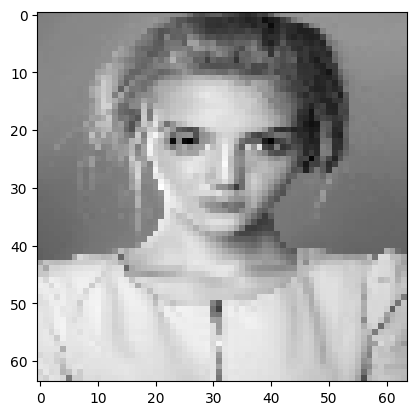

In [9]:
#Female
positive_patches_f = create_patch_list(base_url = positive_female, size = (SIZE[0],SIZE[1]))
positive_patches_f = np.array(positive_patches_f)

print(f"Shape of positive patch array: {positive_patches_f.shape}\n")

test_plot(positive_patches_f)

Shape of positive patch array: (2720, 64, 64)


Load photo for checking...



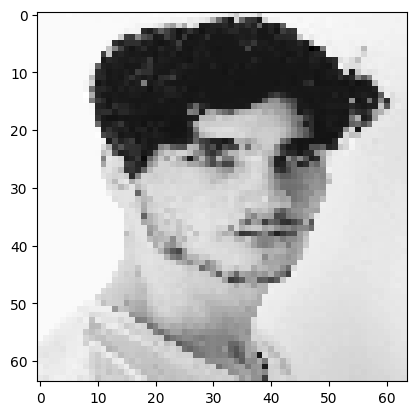

In [10]:
#Male

positive_patches_m = create_patch_list(base_url = positive_male, size = (SIZE[0],SIZE[1]))
positive_patches_m = np.array(positive_patches_m)
print(f"Shape of positive patch array: {positive_patches_m.shape}\n")

test_plot(positive_patches_m)


In [11]:
# Concatenate positive patches
print("Concatenating female and male patches through axis = 0")
positive_patches = np.concatenate((positive_patches_f, positive_patches_m), axis = 0)
print(f"Final positive patches shape: {positive_patches.shape}")

Concatenating female and male patches through axis = 0
Final positive patches shape: (5418, 64, 64)


Simulated Distance Variation (Augmentation):
* scale_factors: List of scaling factors for simulating distance variation.
* augmented_positive_images: A list to hold augmented positive images.
* Loop through each positive image:
  * Simulate distance variations by applying scaling to the image using the simulate_distance_variation() function.
  * Extend the augmented_positive_images list with the simulated images.

In [13]:
# Augment images -> https://github.com/aspagnuolo/Face_detection/blob/main/train_model.ipynb
scale_factors = [1.0]
augmented_positive_images = []
for im in positive_patches:
    simulated_images = simulate_distance_variation(im, scale_factors)
    augmented_positive_images.extend(simulated_images)

In [14]:
# Mirror images
mirror_augmented_positive_images = mirror_images(augmented_positive_images)

In [15]:
len(mirror_augmented_positive_images)
positive_patches = np.array(mirror_augmented_positive_images)

10836

### Collecting negative patches and storing into a list

In [16]:
# negative patches PATHS
landscape_path = "/content/landscapes/"
house_path = "/content/House_Room_Dataset/"
animals_path = "/content/animals/animals/"

Create negative patches using (1/3)
Shape of negative patch array: (4319, 64, 64)


Load photo for checking...



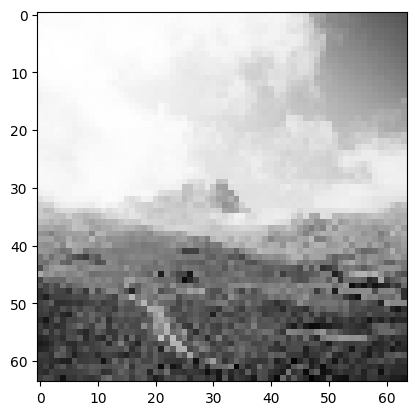

In [18]:
# LANDSCAPES
print("Create negative patches using (1/3)")
#negative_land_patches = create_patch_list(base_url = landscape_path, size = (64, 64))
negative_land_patches = create_patch_list(base_url = landscape_path, size = (SIZE[0],SIZE[1]))
negative_land_patches = np.array(negative_land_patches)

print(f"Shape of negative patch array: {negative_land_patches.shape}\n")

test_plot(negative_land_patches)

Creative negative patches (2/3)
Shape of negative patch array: (5250, 64, 64)


Load photo for checking...



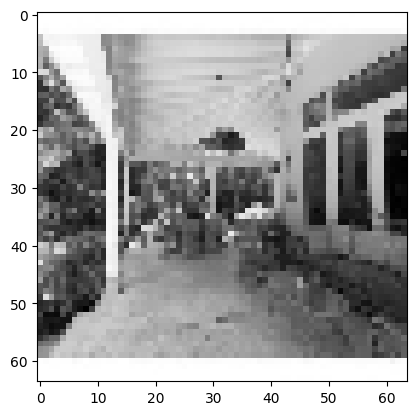

In [19]:
# HOUSES

print(f"Creative negative patches (2/3)")

negative_house_patches = []
for i, f in enumerate(os.listdir(house_path)):
  for j, r in enumerate(os.listdir(house_path + f)):

    img = cv2.imread(house_path + f + "/" + r, cv2.COLOR_RGB2GRAY)
    img_resize = cv2.resize(img, (SIZE[0], SIZE[1]))
    gray = cv2.cvtColor(img_resize, cv2.COLOR_BGR2GRAY)


    negative_house_patches.append(gray)

negative_house_patches = np.array(negative_house_patches)
print(f"Shape of negative patch array: {negative_house_patches.shape}\n")

test_plot(negative_house_patches)

Creative negative patches (3/3)
Shape of negative patch array: (5400, 64, 64)


Load photo for checking...



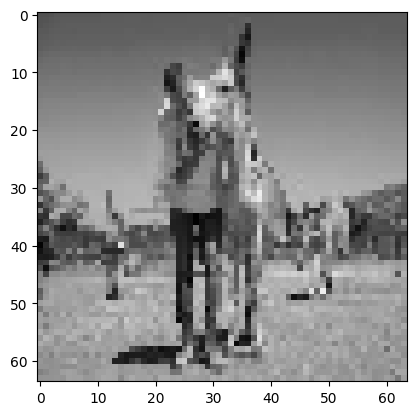

In [20]:
# ANIMALS
print(f"Creative negative patches (3/3)")

negative_animals_patches = []
for i, f in enumerate(os.listdir(animals_path)):
  for j, r in enumerate(os.listdir(animals_path + f)):

    img = cv2.imread(animals_path + f + "/" + r, cv2.COLOR_RGB2GRAY)
    img_resize = cv2.resize(img, (SIZE[0], SIZE[1]))
    gray = cv2.cvtColor(img_resize, cv2.COLOR_BGR2GRAY)


    negative_animals_patches.append(gray)
negative_animals_patches = np.array(negative_animals_patches)
print(f"Shape of negative patch array: {negative_animals_patches.shape}\n")

test_plot(img_list=negative_animals_patches)

In [21]:
# Concatenate negative patches
print("Concatenating house and landscape patches through axis = 0")
negative_patches = np.concatenate((negative_land_patches, negative_house_patches, negative_animals_patches), axis = 0)
print(f"Final negative patches shape: {negative_patches.shape}")

Concatenating house and landscape patches through axis = 0
Final negative patches shape: (14969, 64, 64)


In [22]:
print(f"\n Total patches: Positive: {positive_patches.shape} -- Negative: {negative_patches.shape}")


 Total patches: Positive: (10836, 64, 64) -- Negative: (14969, 64, 64)


Patch Extraction and Augmentation:

* num_patches_per_image: Number of patches to extract from each negative image.
* patch_size: Size of the patches to extract.
* augmented_negative_images: A list to hold augmented negative image patches.
* Loop through each negative image:
  * Extract random patches from the image using the extract_random_patches() function.
  * Extend the augmented_negative_images list with the extracted patches.

In [24]:
num_patches_per_image = 3
patch_size = (64, 64)
augmented_negative_images=[]
for image in negative_patches:
    patches = extract_random_patches(image, num_patches_per_image, patch_size)
    augmented_negative_images.extend(patches)

In [25]:
len(augmented_negative_images)
negative_patches = np.array(augmented_negative_images)

44907

### Creating the Dataset and Labels:
### Dataset: Combined list of augmented positive images and augmented negative image patches.
### labels: List of labels corresponding to the dataset, where 1 represents positive samples and 0 represents negative samples.

In [26]:
dataset = mirror_augmented_positive_images + augmented_negative_images
labels = [1] * len(mirror_augmented_positive_images) + [0] * len(augmented_negative_images)

In [27]:
print(dataset)

[array([[108, 109, 110, ..., 124, 123, 124],
       [109, 109, 110, ..., 124, 124, 125],
       [110, 110, 111, ..., 125, 127, 127],
       ...,
       [195, 192, 187, ..., 153, 150, 148],
       [179, 195, 184, ..., 159, 158, 157],
       [185, 176, 192, ..., 164, 160, 155]], dtype=uint8), array([[115, 117, 117, ..., 113, 111, 108],
       [119, 120, 121, ..., 117, 114, 111],
       [123, 124, 126, ..., 120, 118, 115],
       ...,
       [171, 183, 222, ..., 174, 148, 184],
       [148, 166, 218, ..., 189, 201, 201],
       [133, 150, 146, ..., 204, 151, 129]], dtype=uint8), array([[194, 194, 196, ..., 183, 182, 182],
       [194, 194, 193, ..., 184, 184, 183],
       [194, 195, 191, ..., 183, 183, 184],
       ...,
       [ 17,  16,  16, ...,  14,  13,  11],
       [ 14,  14,  16, ...,  12,  14,  14],
       [ 12,  15,  15, ...,  14,  14,  10]], dtype=uint8), array([[235, 236, 236, ..., 242, 242, 240],
       [234, 236, 235, ..., 242, 242, 241],
       [235, 235, 233, ..., 241, 241, 

In [28]:
print(labels)

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

### Feature Extraction (HOG):

HOG (Histogram of Oriented Gradients) feature extraction is a technique used in computer vision and image processing. It involves analyzing the distribution of gradient orientations in an image to capture its local texture and shape information.
* features_list: A list to store the HOG feature vectors for each image in the dataset.
* Loop through each image in the dataset:
  * Extract HOG features using the get_hog_features() function. This function also implements within it a second function for image resizing (see utils.py). Its deafult arguments are: 
    * _resize_width=64_
    * _resize_height=64_ 
    * _orient = 9_ 
    * _pix_per_cell = 8_
    * _cell_per_block = 2_
  * Append the features to the features_list.

In [31]:
features_list = []
for image in dataset:
    features = get_hog_features(image)
    features_list.append(features)

# Implement the ML model

### Split dataset in X_train, X_test, y_train and y_tes

In [33]:
X_train, X_test, y_train, y_test = train_test_split(features_list, labels, test_size=0.2, random_state=42, stratify=labels)

Convert X_train, X_test, y_train and y_test in numpy array

In [34]:
X_train = to_array(X_train)
y_train = to_array(y_train)
X_test = to_array(X_test)
y_test = to_array(y_test)

## Training the model with FLAML

### Configure AutoML adapted from https://medium.com/@mouse3mic3/a-practical-guide-to-automated-machine-learning-in-python-using-flaml-c73a714887a4

In [115]:
model = AutoML()
model.add_learner('svm', SVM)

model_config = {
    'task'        : 'classification',
    'time_budget' : 3600,     # in seconds
    'max_iter'    : 1000,    # num of model fitting allowed
    'metric'      : 'ap',    # average precision metric
    #'metric'      : precision_metric,    #
    #'eval_method' : 'cv',
    #'split_type'  : 'uniform', # can be uniform or stratified
    #'n_splits'    : 5,          # num of splits
    'estimator_list' : ['svm'],  # list of estimators used
    'verbose'     : 3,
    'log_file_name': 'training_log',
    'log_type'    : 'all'
}


model.fit(X_train, y_train, **model_config)

best_model = model.model

[flaml.automl.logger: 11-13 22:02:17] {1728} INFO - task = classification
[flaml.automl.logger: 11-13 22:02:17] {1739} INFO - Evaluation method: holdout
[flaml.automl.logger: 11-13 22:02:20] {1838} INFO - Minimizing error metric: 1-ap
[flaml.automl.logger: 11-13 22:02:20] {1955} INFO - List of ML learners in AutoML Run: ['svm']
[flaml.automl.logger: 11-13 22:02:20] {2258} INFO - iteration 0, current learner svm
[flaml.automl.logger: 11-13 22:02:41] {2393} INFO - Estimated sufficient time budget=806073s. Estimated necessary time budget=806s.
[flaml.automl.logger: 11-13 22:02:41] {2442} INFO -  at 23.2s,	estimator svm's best error=0.3541,	best estimator svm's best error=0.3541
[flaml.automl.logger: 11-13 22:02:41] {2258} INFO - iteration 1, current learner svm
[flaml.automl.logger: 11-13 22:03:14] {2442} INFO -  at 56.7s,	estimator svm's best error=0.2080,	best estimator svm's best error=0.2080
[flaml.automl.logger: 11-13 22:03:14] {2258} INFO - iteration 2, current learner svm
[flaml.au

In [ ]:
# Evaluation model
test_accuracy = best_model.score(X_test, y_test)
print(f'Test accuracy: {test_accuracy:.3f}')

# probability predictions in order to predict_proba on best_model
test_probabilities = best_model.predict_proba(X_test)
print("Test probabilities:", test_probabilities)

In [ ]:
# Print the best hyperparameters
best_params = model.best_config
print("Best hyperparameters:")
print(best_params)

### Save the model

In [116]:
with open("my_model.pkl", "wb") as f:
    pickle.dump(model, f, pickle.HIGHEST_PROTOCOL)

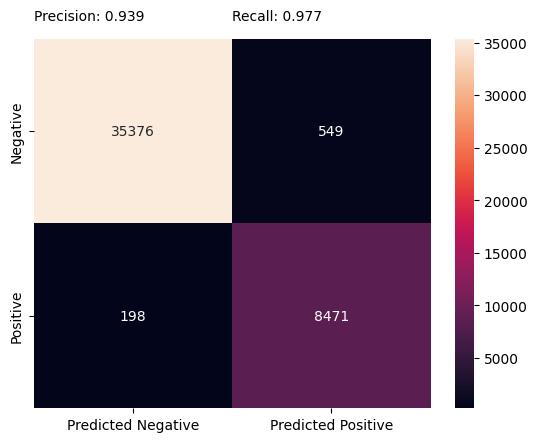

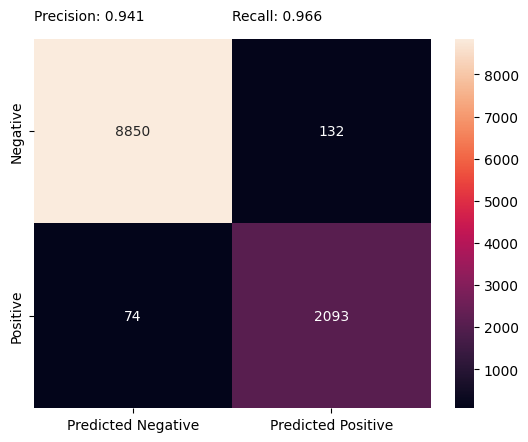

In [117]:
plot_confusion_matrix(y_train, model.predict(X_train))
plot_confusion_matrix(y_test, model.predict(X_test))

# Face Detection

In [ ]:
pipeline = FaceDetectionPipeline(classifier=model)
pipeline.run("/content/test/Maradona.jpg")

# References

1) https://medium.com/@mouse3mic3/a-practical-guide-to-automated-machine-learning-in-python-using-flaml-c73a714887a4

2) H. Chandra, ‘Pipelines & Custom Transformers in scikit-learn: The step-by-step guide (with Python code)’, Medium, Jun. 27, 2020. https://towardsdatascience.com/pipelines-custom-transformers-in-scikit-learn-the-step-by-step-guide-with-python-code-4a7d9b068156.

3) M. Tyagi, ‘HOG(Histogram of Oriented Gradients)’, Medium, Jul. 24, 2021. https://towardsdatascience.com/hog-histogram-of-oriented-gradients-67ecd887675f

4) N. Dalal and B. Triggs, ‘Histograms of oriented gradients for human detection’, in 2005 IEEE computer society conference on computer vision and pattern recognition (CVPR’05), Ieee, 2005, pp. 886–893.

5) C.-H. Yuan, ‘Face-Detection-with-a-Sliding-Window’. May 30, 2023. [Online]. Available: https://github.com/lionelmessi6410/Face-Detection-with-a-Sliding-Window

6) ‘Face Detection Project’. https://www.cc.gatech.edu/classes/AY2016/cs4476_fall/results/proj5/html/agartia3/index.html

7) J. Hosang, R. Benenson, and B. Schiele, ‘Learning non-maximum suppression’, in Proceedings of the IEEE conference on computer vision and pattern recognition, 2017, pp. 4507–4515.

8) "ProfAI: A Virtual Data Science Coach," ProfessionAI, 2023. Online. Available: https://prof.profession.ai/

9) “ChatGPT”. OpenAI's ChatGPT, 2023 - Conversational AI Language Model. [Online]. Available: https://chat.openai.com/

10) https://colab.research.google.com/drive/1H5jn1nzTA1Y0FpsbKEIZYoA3VoKPp_3Z?usp=sharing